<div style="padding: 15px; border: 5px solid transparent; border-color: transparent; margin-bottom: 20px; border-radius: 4px; color: #3c763d; background-color: #dff0d8; border-color: #d6e9c6; font-weight: bold;">
    <br><br>
    <div style="font-weight: bold; font-size: 40px">실무에서 사용하는 인공지능 컴퓨터비전</div>
    <div style="font-weight: bold; font-size: 20px">[05-06] Style Transfer</div>
    <hr style="width:80%;text-align:left;margin-left:0;border:0.5px solid green">
    <br>
    &#x2022; 이미지의 스타일을 바꿔주는 Style Transfer 딥러닝 모델을 적용하는 과정을 이해할 수 있다. <br>
    &#x2022; 원하는 이미지를 원하는 스타일로 바꿀 수 있다. <br>
    &#x2022; 동영상 플레이어에 이미지 스타일을 바꿔주는 Style Transfer 모델을 적용시킬 수 있다. <br>
</div>

<div style="padding: 15px; border: 5px solid transparent; border-color: transparent; margin-bottom: 20px; border-radius: 4px; color: #3c763d; border-color: #d6e9c6; font-weight: bold;">
<h2 style='font-weight: bold'>1. 이미지의 스타일을 바꿔주는 딥러닝 모델</h2>
</div> 

이미지의 스타일을 바꿔주는 모델을 사용해봅시다. 

eccv16 모델의 스타일 이미지입니다. 

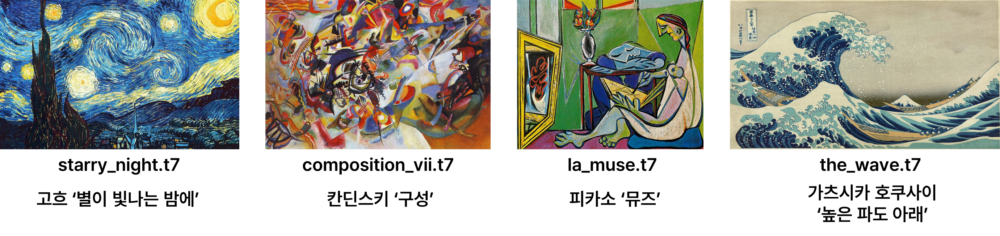


instance_norm 모델의 스타일 이미지입니다. 

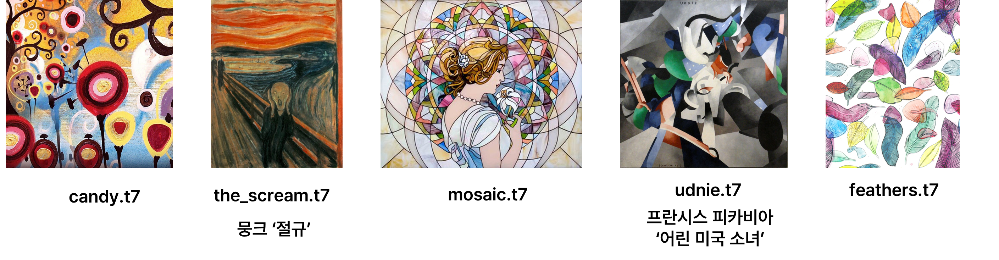


<div style="padding: 15px; border: 5px solid transparent; border-color: transparent; margin-bottom: 20px; border-radius: 4px; color: #3c763d; border-color: #d6e9c6; font-weight: bold;">
<h2 style='font-weight: bold'>2. 패키지 불러오기</h2>
</div> 

사용할 패키지와 이미지를 불러오세요. 

```python
import cv2
# OpenCV 패키지
import numpy as np
# 행렬 연산을 도와주는 패키지

cv2.dnn.readNetFromTorch('models/eccv16/starry_night.t7')
# 고흐의 ‘별이 빛나는 밤’ 화풍을 따라하는 모델을 로드합니다. 


```

In [ ]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

net = cv2.dnn.readNetFromTorch('models/eccv16/starry_night.t7')

img = cv2.imread('cake.jpg')
img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

plt.imshow(img)
plt.axis('off')
plt.show()

<div style="padding: 15px; border: 5px solid transparent; border-color: transparent; margin-bottom: 20px; border-radius: 4px; color: #3c763d; border-color: #d6e9c6; font-weight: bold;">
<h2 style='font-weight: bold'>3. 전처리</h2>
</div> 

전처리는 모델의 성능을 높이기 위한 방법입니다. 

이미지의 높이, 너비, 채널을 각각 변수에 저장하고, 이미지의 크기를 변경합니다. 

blobFromImage() 함수를 이용해서 이미지의 각 픽셀에서 MEAN_VALUE를 빼고 사용해서 차원을 변경합니다. 


```python
h, w, c = img.shape
# 이미지의 높이, 너비, 채널을 각각 변수에 저장합니다. 

img = cv2.resize(img, dsize=(500, int(h / w * 500)))
# 가로=500, 세로=가로 500에 맞는 세로 비율)

MEAN_VALUE = [103.939, 116.779, 123.680]
blob = cv2.dnn.blobFromImage(img, mean=MEAN_VALUE)
# 이미지의 각 픽셀에서 MEAN_VALUE를 빼기 
# 차원 변경



```

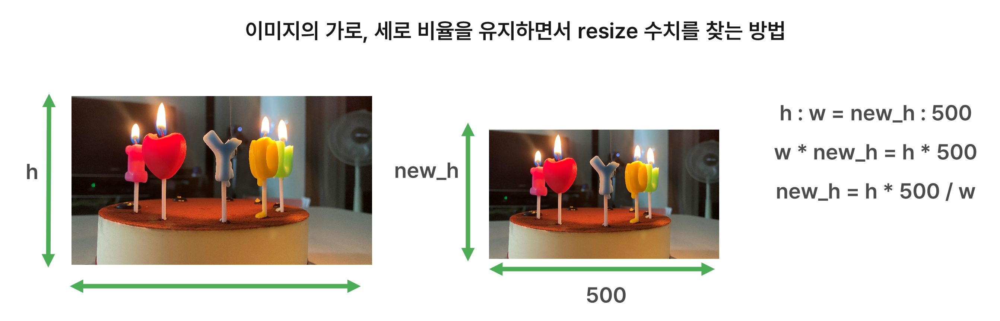

In [ ]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

net = cv2.dnn.readNetFromTorch('models/eccv16/starry_night.t7')

img = cv2.imread('cake.jpg')
img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

h, w, c = img.shape

img = cv2.resize(img, dsize=(500, int(h / w * 500)))
print(img.shape)

MEAN_VALUE = [103.939, 116.779, 123.680]
blob = cv2.dnn.blobFromImage(img, mean=MEAN_VALUE)
print(blob.shape)

plt.imshow(img)
plt.axis('off')
plt.show()

변경된 차원은 shape를 출력해서 확인할 수 있어요. 

딥러닝 모델에 넣기 전에 차원을 변경해서 컴퓨터가 계산할 수 있는 형태로 만들어줍니다. 

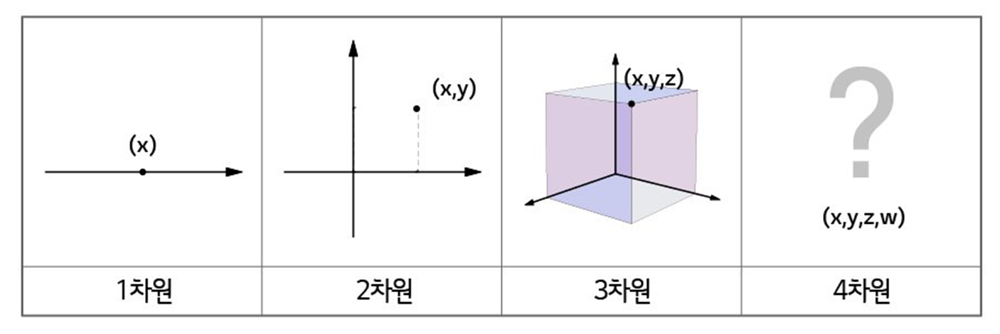

<div style="padding: 15px; border: 5px solid transparent; border-color: transparent; margin-bottom: 20px; border-radius: 4px; color: #3c763d; border-color: #d6e9c6; font-weight: bold;">
<h2 style='font-weight: bold'>4. 추론하기</h2>
</div> 

전처리한 이미지(blob)를 모델에 넣고 추론합니다. 

output 변수에 추론한 결과가 저장됩니다. 

```python
net.setInput(blob)
# 전처리한 결과를 입력값을 지정
output = net.forward()
# 추론해서 output에 저장
```


<div style="padding: 15px; border: 5px solid transparent; border-color: transparent; margin-bottom: 20px; border-radius: 4px; color: #3c763d; border-color: #d6e9c6; font-weight: bold;">
<h2 style='font-weight: bold'>5. 이미지 후처리하기</h2>
</div> 


추론한 결과를 숫자로 볼 수도 있지만 우리는 이미지로 보기를 원하기 때문에 숫자 → 이미지 변환과정을 처리하겠습니다. 
```python
output = output.squeeze().transpose((1,2,0))
# squeeze() 차원 줄이기
# transpose((1,2,0)) 차원 변형했던 것을 원래대로 (높이, 너비, 채널) 순서로 되돌림
output += MEAN_VALUE
# MEAN_VALUE 다시 더함

output = np.clip(output, 0, 255)
# 255가 넘는 값은 모두 255로 바꿔서 값의 범위 제한
output = output.astype('uint8')
# 정수 형태로 값이 바뀜
```



<div style="padding: 15px; border: 5px solid transparent; border-color: transparent; margin-bottom: 20px; border-radius: 4px; color: #3c763d; border-color: #d6e9c6; font-weight: bold;">
<h2 style='font-weight: bold'>6. 결과 이미지 출력하기</h2>
</div> 

추론한 결과 이미지를 출력합니다. 

```python
plt.imshow(output)
```

In [ ]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

net = cv2.dnn.readNetFromTorch('models/eccv16/starry_night.t7')

img = cv2.imread('cake.jpg')
img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

h, w, c = img.shape

img = cv2.resize(img, dsize=(500, int(h / w * 500)))

MEAN_VALUE = [103.939, 116.779, 123.680]
blob = cv2.dnn.blobFromImage(img, mean=MEAN_VALUE)

net.setInput(blob)
output = net.forward()

output = output.squeeze().transpose((1,2,0))
output += MEAN_VALUE

output = np.clip(output, 0, 255)
output = output.astype('uint8')

plt.imshow(output)
plt.axis('off')
plt.show()


<div style="padding: 15px; border: 5px solid transparent; border-color: transparent; margin-bottom: 20px; border-radius: 4px; color: #8a6d3b;  border-color: #faebcc; font-weight: bold;">
    <div style="font-weight: bold; font-size: 20px">✏️ [미션1]</div>
    <br>
    내가 고른 이미지에 다양한 style을 적용하세요.
</div>

(예시)

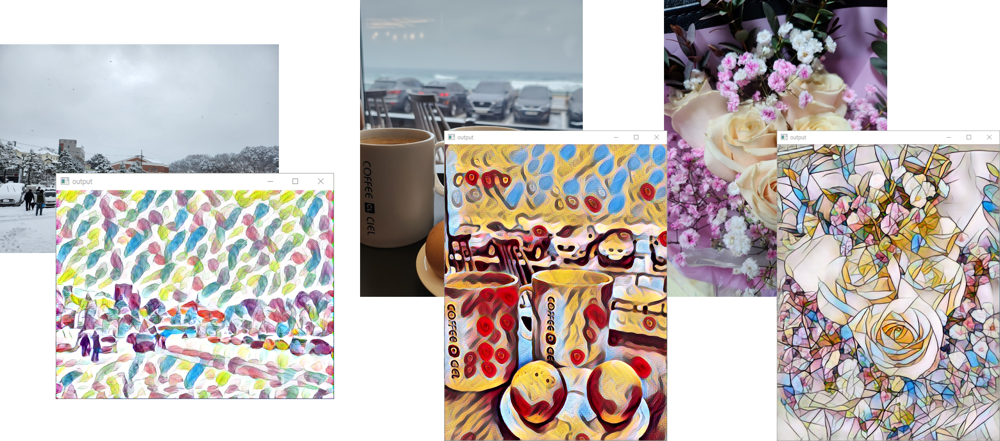

<div style="padding: 15px; border: 5px solid transparent; border-color: transparent; margin-bottom: 20px; border-radius: 4px; color: #8a6d3b;  border-color: #faebcc; font-weight: bold;">
    <div style="font-weight: bold; font-size: 20px">✏️ [미션2]</div>
    <br>
액자 안의 이미지를 잘라서 style을 적용하세요. <br><br>    
1. 액자 안 이미지의 좌표를 찾는다.<br>
2. 액자 안 이미지를 cropped_img 변수에 저장<br>
3. 이미지 전처리, 추론, 이미지 후처리 과정은 같음<br>
4. 이미지 출력<br>


</div>

(예시)

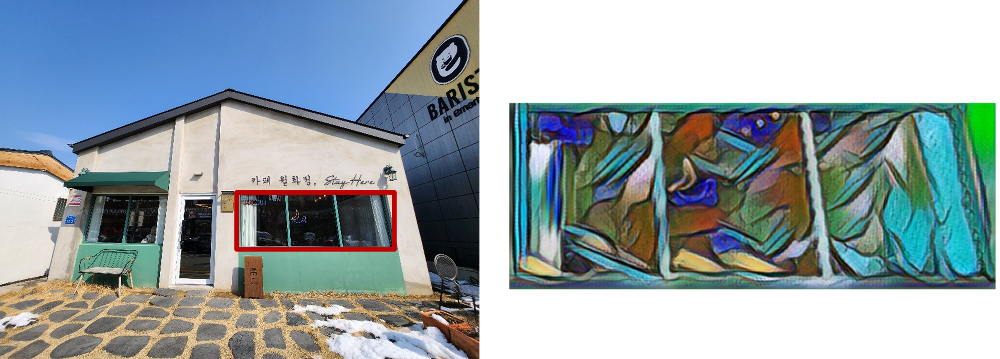

<div style="padding: 15px; border: 5px solid transparent; border-color: transparent; margin-bottom: 20px; border-radius: 4px; color: #8a6d3b;  border-color: #faebcc; font-weight: bold;">
    <div style="font-weight: bold; font-size: 20px">✏️ [미션3]</div>
    <br>
액자 안에 바뀐 이미지를 넣어주세요. <br><br>
1. 미션2에서 style 변경한 output을 원래 cropped_img의 크기로 resize<br>
2. 잘라낸 부분에 붙임(예: img[162:513, 185:428]=output)<br>
3. 전체 이미지 w:500으로 resize<br>
4. 이미지 출력<br>
</div>

(예시)

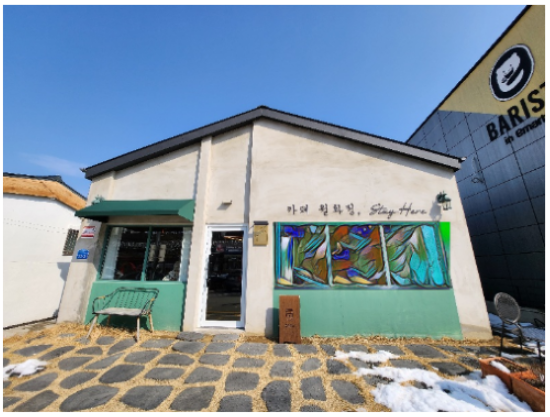

<div style="padding: 15px; border: 5px solid transparent; border-color: transparent; margin-bottom: 20px; border-radius: 4px; color: #8a6d3b;  border-color: #faebcc; font-weight: bold;">
    <div style="font-weight: bold; font-size: 20px">✏️ [미션4]</div>
    <br>
이미지의 style을 세로로 반반 다르게 적용해봅시다.  <br><br>
1. 원본 이미지의 w를 2로 나누어서 cropped_img1과 cropped_img2를 따로 저장<br>
2. cropped_img1과 cropped_img2에 이미지 전처리, 추론, 이미지 후처리 적용<br>
3. cropped_img1과 cropped_img2 합치기(output = np.concatenate([output1, output2], axis=1))<br>
4. 이미지 w:500으로 resize 후 이미지 출력<br>
</div>

(예시)

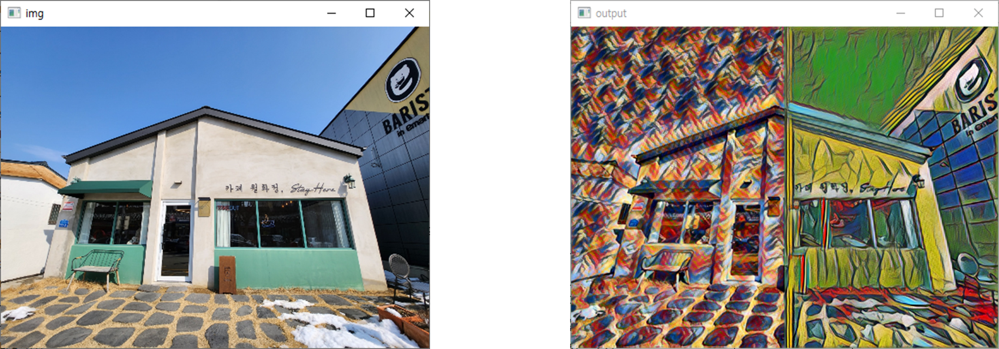

<div style="padding: 15px; border: 5px solid transparent; border-color: transparent; margin-bottom: 20px; border-radius: 4px; color: #8a6d3b;  border-color: #faebcc; font-weight: bold;">
    <div style="font-weight: bold; font-size: 20px">✏️ [미션5]</div>
    <br>
동영상은 이미지의 연속입니다. 동영상을 Style Transfer 하세요.
</div>

(예시)

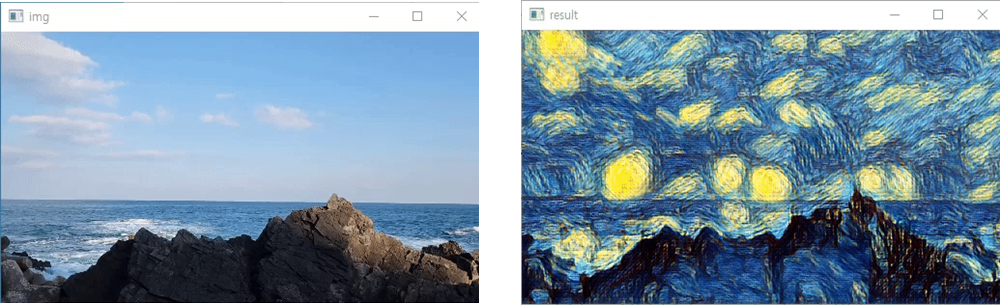
